## Problem Statement and Motivation
Asteroids are classified into three main categories (C, S, and  M). We are interested in the M-type (metallic) asteroids. Manually classifying asteroids can be a slow and tedious process due to the number of observations we need to gather sufficient data. The goal of this project is to predict if asteroids are metallic using data that is faster and easier to gather. We can imagine a future where humans are mining asteroids for resources. A model such as this could be used to speed up the process of searching for metallic asteroids. This could also be used to help identify the most profitable asteroids in the early stages of asteroid mining.

## Imports and Setup

In [1]:
import numpy as np
import pandas as pd
import pandas_profiling
import math

import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder

from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipeline

from sklearn.model_selection import cross_val_predict
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix

Dataset: https://www.kaggle.com/basu369victor/prediction-of-asteroid-diameter

In [2]:
asteroids = pd.read_csv("~/data/Asteroid_Updated.csv")

C:\Users\mitch\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3166: DtypeWarning: Columns (0,10,15,16,23,24) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


### Description of Dataset Columns
* full_name: Object full name/designation
* a: semi-major axis(au)
* e: eccentricity
* G: Magnitude slope parameter
* i: Inclination with respect to x-y ecliptic plane(deg)
* om: Longitude of the ascending node
* w: argument of perihelion
* q: perihelion distance(au)
* ad: aphelion distance(au)
* per_y: Orbital period
* data_arc: data arc-span(d)
* condition_code: Orbit condition code
* n_obs_used: number of observations used
* H: Absolute Magnitude parameter
* diameter: Diameter of asteroid(Km)
* extent: Object bi/tri axial ellipsoid dimensions(Km)
* albedo: geometric albedo
* rot_per: Rotation Period(h)
* GM: Standard gravitational parameter, Product of mass and gravitational constant
* BV: Color index B-V magnitude difference
* UB: Color index U-B magnitude difference
* IR: Color index I-R magnitude difference
* spec_B: Spectral taxonomic type(SMASSII)
* spec_T: Spectral taxonomic type(Tholen)
* neo: Near Earth Object
* pha: Physically Hazardous Asteroid
* moid: Earth Minimum orbit Intersection Distance(au)

## Preliminary Exploration of Asteroids Dataset

In [3]:
# This generates a summary of the dataset detailing distributions, correlations, missing values, summary statistics, etc.
# This report might not show up in GitHub
pandas_profiling.ProfileReport(asteroids)

Summarize dataset:   0%|          | 0/45 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data Cleaning and Preprocessing

In [4]:
# Need 'spec_B' and 'spec_T' to determine if an asteroid is metallic
cleaned_asteroids = asteroids[~asteroids['spec_B'].isna() | ~asteroids['spec_T'].isna()]

# Remove unwanted data
cleaned_asteroids.drop(['name', 'extent', 'GM', 'IR', 'G', 'neo', 'pha', 'condition_code', 'class'], axis = 1, inplace = True)

# drop due to high correlation
cleaned_asteroids.drop(['a', 'per', 'per_y', 'moid'], axis = 1, inplace = True)

# not useful for model
cleaned_asteroids.drop(['n_obs_used', 'ma'], axis = 1, inplace = True)

# Convert 'diameter' from class to numeric data type
cleaned_asteroids = cleaned_asteroids.astype(dtype = {'diameter':'float64'}, copy=True, errors='raise')

# This is useful for visualizing features later
for_feature_viz = cleaned_asteroids.drop(['spec_B', 'spec_T'], axis = 1)

# Since we're predicting if the asteroid is 'metallic', we probably won't have these values
cleaned_asteroids.drop(['BV', 'UB'], axis = 1, inplace = True)

C:\Users\mitch\Anaconda3\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [5]:
# Remove bad observation
cleaned_asteroids = cleaned_asteroids.drop(541682, axis = 0)

In [6]:
# Determine which observations are metallic based on spec_B and spec_T

cleaned_asteroids['spec_B'].replace({'Xk':'1', 'Xc':'1', 'Xe':'1', 'X:':'1'}, inplace = True)
cleaned_asteroids.loc[:,'spec_B'].iloc[cleaned_asteroids['spec_B'] != '1'] = '0'
cleaned_asteroids = cleaned_asteroids.astype(dtype = {'spec_B':'int32'}, copy=True, errors='raise')

cleaned_asteroids['spec_T'].replace({'E':'1', 'M':'1', 'X':'1', 'X:':'1', 'XC':'1', 'XC:':'1', 'XD':'1', 'XD:':'1'}, inplace = True)
cleaned_asteroids.loc[:,'spec_T'].iloc[cleaned_asteroids['spec_T'] != '1'] = '0'
cleaned_asteroids = cleaned_asteroids.astype(dtype = {'spec_T':'int32'}, copy=True, errors='raise')

cleaned_asteroids.loc[:,'metallic'] = (cleaned_asteroids['spec_B'] + cleaned_asteroids['spec_T'] > 0)*1
cleaned_asteroids = cleaned_asteroids.drop(['spec_T', 'spec_B'], axis = 1) # no longer needed

C:\Users\mitch\Anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [7]:
# Train test split
asteroids_train, asteroids_test = train_test_split(cleaned_asteroids, test_size=0.33, random_state = 0)

## Post Cleaning Inspection

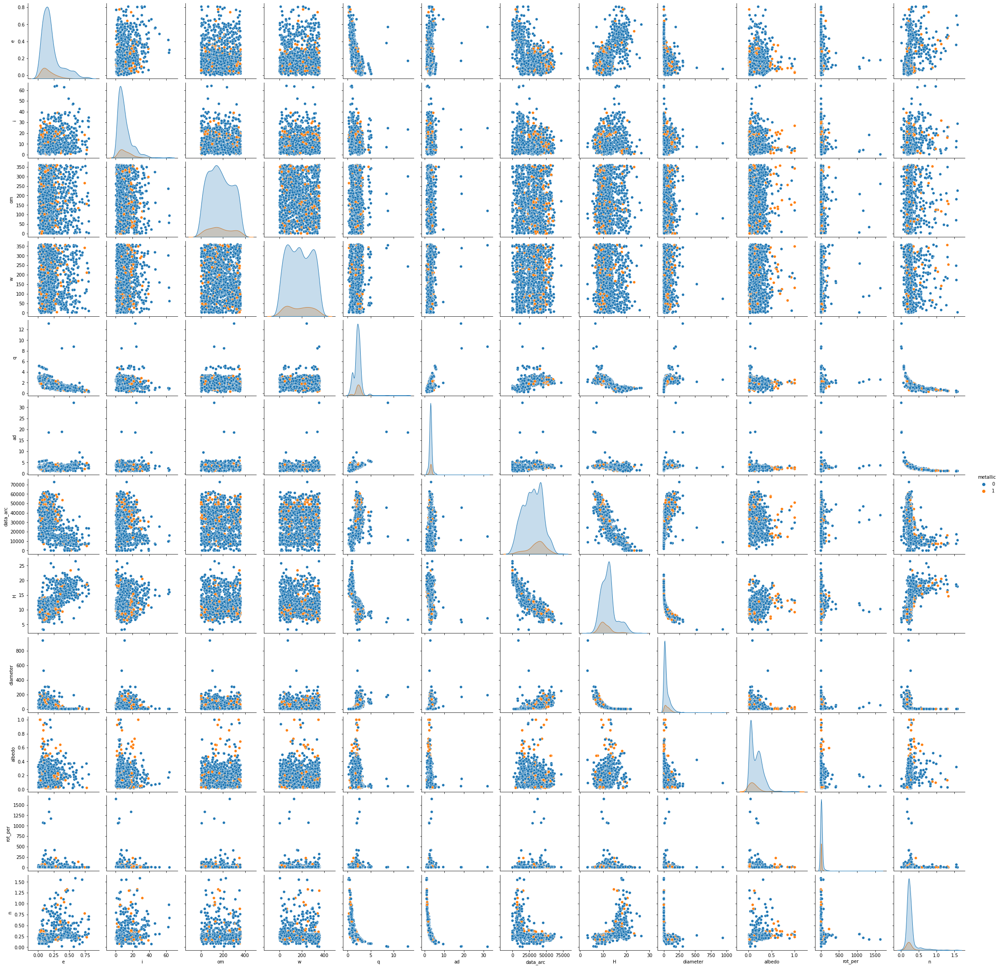

In [8]:
sns.pairplot(asteroids_train, kind = 'scatter', hue = 'metallic')

Upon inspecting the pair plot, we can see that there is a lot of overlap between the metallic and non-metallic asteroids. We can't be sure yet, but it looks like ensemble techniques might be the best considering our smaller data set.
<br/><br/>

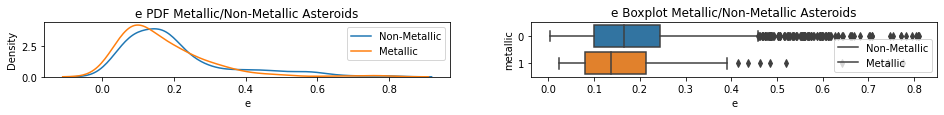

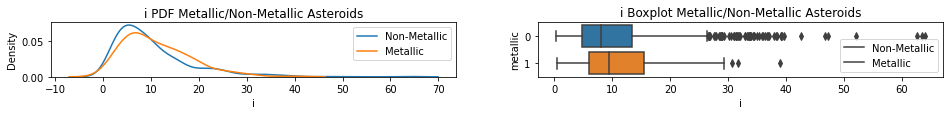

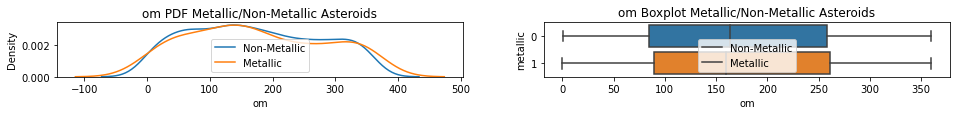

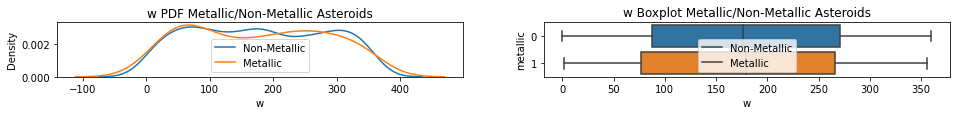

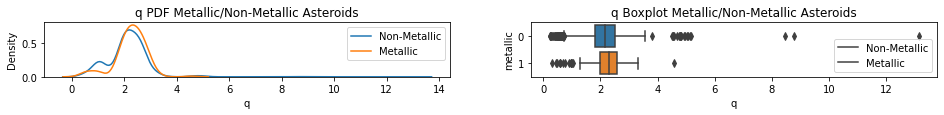

...

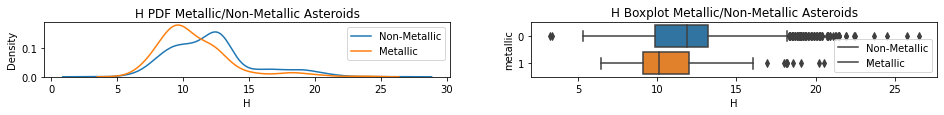

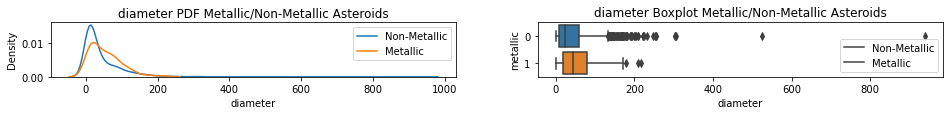

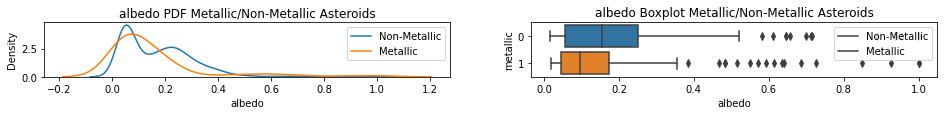

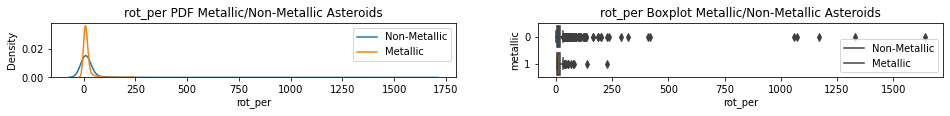

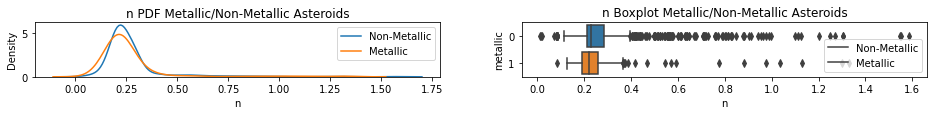

In [9]:
for col_name in asteroids_train.drop('metallic', axis = 1).columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 1))
    sns.kdeplot(x = asteroids_train[asteroids_train['metallic'] == 0][col_name], ax=ax1)
    sns.kdeplot(x = asteroids_train[asteroids_train['metallic'] == 1][col_name], ax=ax1)
    ax1.legend(['Non-Metallic', 'Metallic'])
    ax1.set_title(col_name + ' PDF Metallic/Non-Metallic Asteroids')
    
    sns.boxplot(x = col_name, y = 'metallic', data = asteroids_train, orient = 'h', ax=ax2)
    ax2.legend(['Non-Metallic', 'Metallic'])
    ax2.set_title(col_name + ' Boxplot Metallic/Non-Metallic Asteroids')

Looking at the plots above it looks 'data_arc', 'H', 'diameter', 'albedo', and maybe 'rot_per' would be decent features on their own. Some other features like 'i' and 'e' might end up being useful after some feature engineering. Features like 'om', 'q', 'w', and 'ad' look much less promising, so we will probably drop them. 
<br/>

## Feature Engineering and Pipeline Function

In [10]:
X_train, y_train = asteroids_train.drop('metallic', axis=1), asteroids_train['metallic']

X_train = X_train.reset_index().drop('index', axis=1)
y_train = pd.DataFrame(y_train).reset_index().drop('index', axis=1)['metallic']

In [11]:
# Preliminaries for Feature Engineering and Pipeline 
imputer = KNNImputer(n_neighbors = 5, weights="uniform", copy = False, add_indicator = True)
imputer.fit(X_train)

ss = StandardScaler(copy = False)

# after some feature selection, these features on their own are no longer useful
drop_original = ['ad', 'w', 'e', 'om', 'q', 'diameter', 'n', 'albedo']

### Potential Feature Visualization
I used the autofeat library to generate a list of potentially useful features for my model.

In [12]:
# # List of Considered Features
def viz_considered_features(X):
    X_copy = X.copy()
    
    imputer.transform(X_copy)
    
    X_copy['ad**2/i'] = X_copy['ad']**2/X_copy['i']
    X_copy['n**2*log(n)'] = X_copy['n']**2*np.log(X_copy['n'])
    X_copy['n*q'] = X_copy['n']*X_copy['q']
    X_copy['H*sqrt(diameter)'] = X_copy['H']*np.sqrt(X_copy['diameter'])
    X_copy['Abs(albedo - sqrt(e))'] = abs(X_copy['albedo'] - np.sqrt(X_copy['e']))
    X_copy['Abs(exp(n) + log(albedo))'] = abs(np.exp(X_copy['n']) + np.log(X_copy['albedo']))
    X_copy['Abs(sqrt(H) + log(albedo))'] = abs(np.sqrt(X_copy['H']) + np.log(X_copy['albedo']))
    X_copy['1/(log(albedo) + 1/H)'] = 1/(np.log(X_copy['albedo']) + 1/X_copy['H'])
    X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo'])
    X_copy['e*exp(-i)'] = X_copy['e']*np.exp(-X_copy['i'])
    X_copy['1/(exp(q) - log(w))'] = 1/(np.exp(X_copy['q']) - np.log(X_copy['w']))
    X_copy['1/(diameter**2 + w)'] = 1/(X_copy['diameter']**2 + X_copy['w'])
    X_copy['1/(diameter**3 - om**3)'] = 1/(X_copy['diameter']**3 - X_copy['om']**3)
    X_copy['Abs(log(diameter) - log(i))'] = abs(np.log(X_copy['diameter']) - np.log(X_copy['i']))
    X_copy['1/(H**3 + diameter**3)'] = 1/(X_copy['H']**3 + X_copy['diameter']**3)
    X_copy['(q**2 - log(data_arc))**2'] = (X_copy['q']**2 - np.log(X_copy['data_arc']))**2
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))

    X_copy['exp(-q) / n**3'] = np.exp(-X_copy['q']) / (X_copy['n'])**3
    X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
    X_copy['n * exp(-n**2)'] = X_copy['n'] * np.exp(-X_copy['n']**2)
    X_copy['1 / (exp(q) + 1/albedo)'] =1 / (np.exp(X_copy['q']) + 1/X_copy['albedo'])
    X_copy['Abs(albedo**3 - 1/ad)'] = abs(X_copy['albedo']**3 - 1/X_copy['ad'])
    X_copy['Abs(sqrt(ad) - exp(albedo))'] = abs(np.sqrt(X_copy['ad']) - np.exp(X_copy['albedo']))
    X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])
    X_copy['n*log(ad)'] = X_copy['n'] * np.log(X_copy['ad'])
    X_copy['log(om)/ad'] = np.log(X_copy['om']) / X_copy['ad']
    X_copy['H**3/albedo'] = X_copy['H']**3 / X_copy['albedo']
    X_copy['exp(e)*log(n)'] = np.exp(X_copy['e']) * np.log(X_copy['n'])
    
    i = 8
    while i < len(X_copy.columns) + 8:
        X_slice = X_copy.iloc[:, i-8 : min(i, len(X_copy)-2)]
        sns.pairplot(
            data = pd.concat([ X_slice, for_feature_viz[['BV', 'UB']] ], axis = 1),
            x_vars = X_slice.columns,
            y_vars = ['BV', 'UB'],
            kind = 'reg',
            plot_kws = {'ci':None, 'marker':'.'}
        )
        i += 8
    

<br/>
The 'BV' and 'UB' variables are good predictors of metallic asteroids but are time-consuming to measure. The idea with the plots below is that if a feature is a good predictor of either 'BV' or 'UB', then it's probably a good predictor of metallic asteroids.

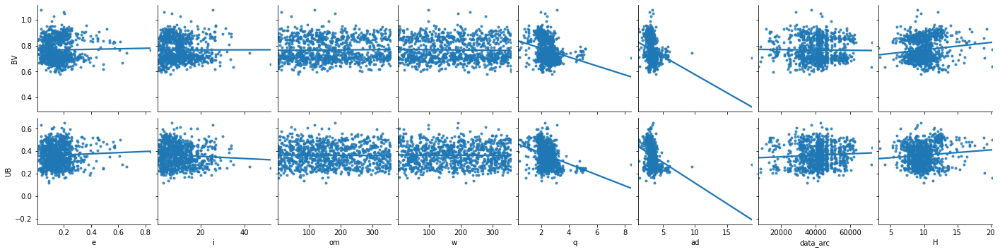

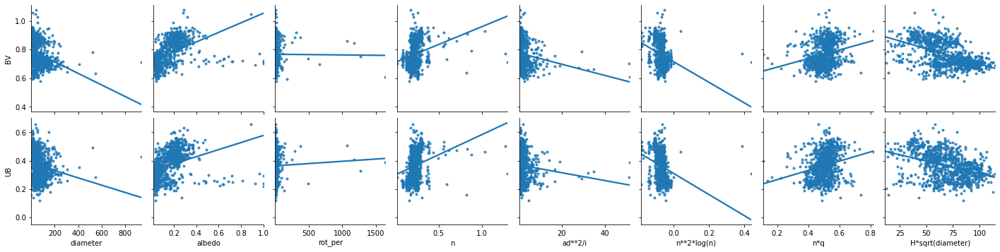

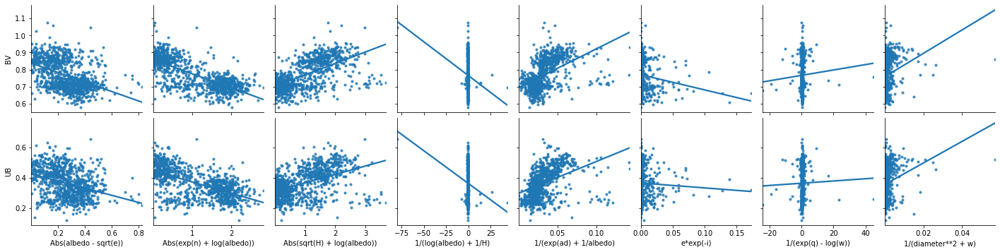

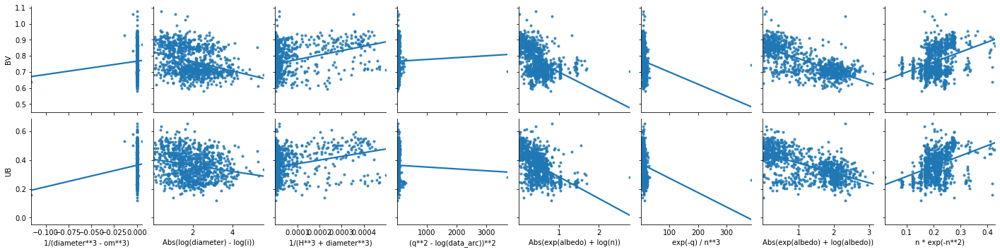

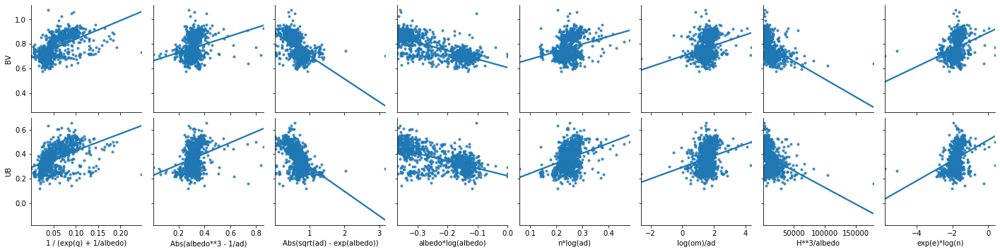

In [13]:
viz_considered_features(for_feature_viz.drop(['BV', 'UB'], axis = 1))

### Pipeline Function

In [14]:
def pipeline(X, test = False):
    X_copy = X.copy()
    
    # handle missing values
    if not test:
        imputer.fit_transform(X_copy)
    else: # test is True
        imputer.transform(X_copy)
        
    # These 'BV_estimate' and 'UB_estimate' are a work in progress
#     # Use gradientBoosting regressor to estimate the value of BV (Color index B-V magnitude difference)
#     X_copy['BV_estimate'] = model_BV.predict(feature_engineering_BV(X_copy))
    
#     # Use gradientBoosting regressor to estimate the value of UB (Color index U-B magnitude difference)
#     X_copy['UB_estimate'] = model_UB.predict(feature_engineering_UB(X_copy.drop('BV_estimate', axis = 1)))
    
    # Best features after feature selection
    X_copy['n*q'] = X_copy['n']*X_copy['q']
    X_copy['H*sqrt(diameter)'] = X_copy['H']*np.sqrt(X_copy['diameter'])
    X_copy['Abs(exp(n) + log(albedo))'] = abs(np.exp(X_copy['n']) + np.log(X_copy['albedo']))
    X_copy['Abs(sqrt(H) + log(albedo))'] = abs(np.sqrt(X_copy['H']) + np.log(X_copy['albedo']))
    X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo'])
    X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
    X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])

    
    # Drop Unwanted Original Features
    X_copy.drop(drop_original, axis = 'columns', inplace = True)
    
    
    # Standardize data
    if not test:
        ss.fit_transform(X_copy)
    else: # test == True
        ss.transform(X_copy)
     
        
        
    return X_copy



In [15]:
# Process Data
processed_X_train = pipeline(X_train)

## Inspection of Engineered Features
Features were selected by considering the plots in the following cells and the feature importances from ensemble methods. Features were removed from the pipeline function one by one until only the ones visualized below remained.

In [16]:
# Preliminaries for post feature engineering pair plot
processed_asteroids_train = pd.concat([processed_X_train, y_train.reset_index()['metallic']], axis = 1)


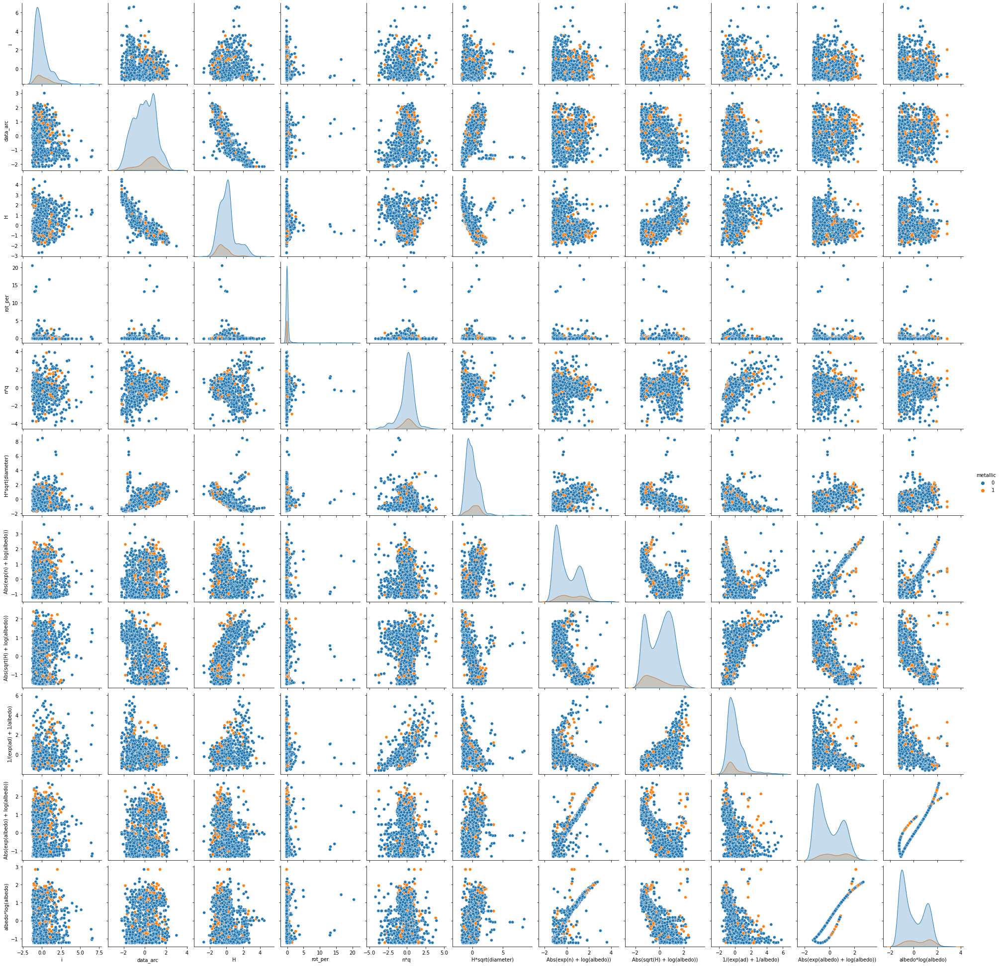

In [17]:
sns.pairplot(processed_asteroids_train, kind = 'scatter', hue = 'metallic')

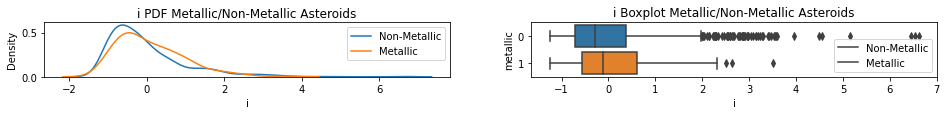

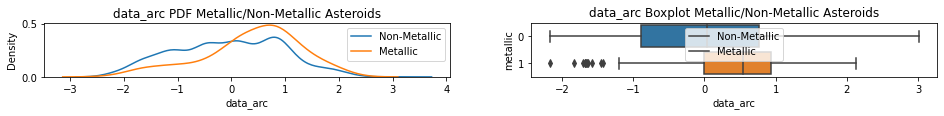

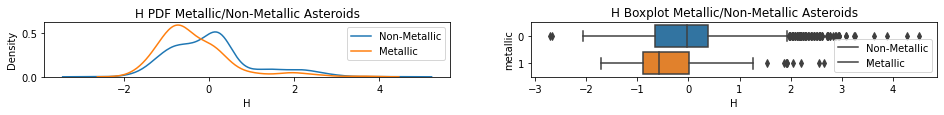

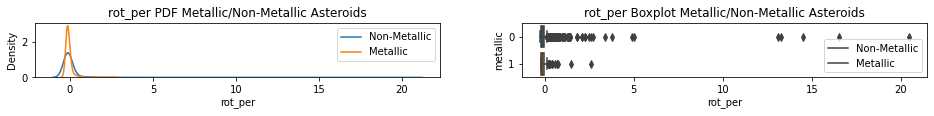

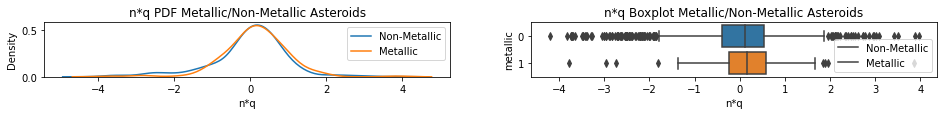

...

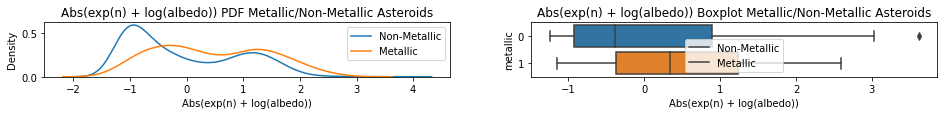

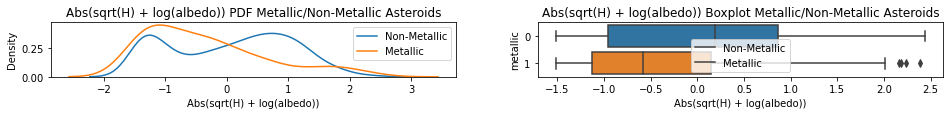

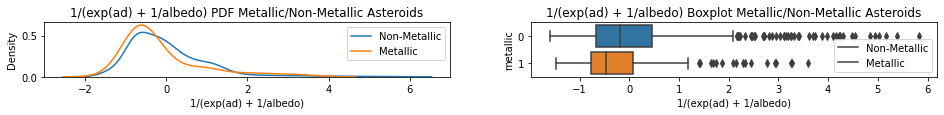

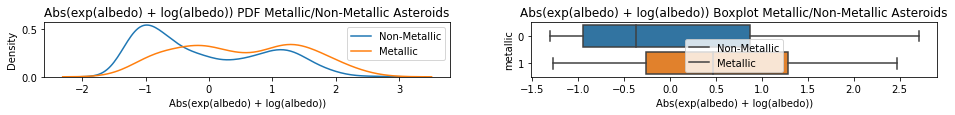

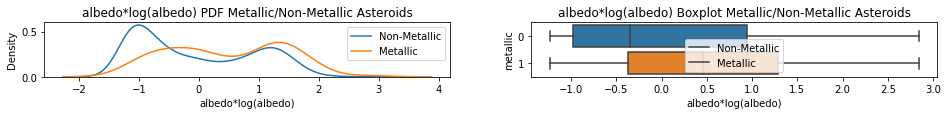

In [18]:
for col_name in processed_X_train.columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 1))
    sns.kdeplot(x = processed_asteroids_train[processed_asteroids_train['metallic'] == 0][col_name], ax=ax1)
    sns.kdeplot(x = processed_asteroids_train[processed_asteroids_train['metallic'] == 1][col_name], ax=ax1)
    ax1.legend(['Non-Metallic', 'Metallic'])
    ax1.set_title(col_name + ' PDF Metallic/Non-Metallic Asteroids')
    
    sns.boxplot(x = col_name, y = 'metallic', data = processed_asteroids_train, orient = 'h', ax=ax2)
    ax2.legend(['Non-Metallic', 'Metallic'])
    ax2.set_title(col_name + ' Boxplot Metallic/Non-Metallic Asteroids')

## Training and 10-Fold Cross Validation

In [19]:
def evaluate_model(model, X, y):
    
    # So that SMOTE over sampling is used wtih cross validation
    smote_model = imbpipeline(steps = [['smote', SMOTE(random_state = 0)],
                                        ['classifier', model]])
    
    # 10-Fold Cross Validation
    prediction_probs = cross_val_predict(smote_model, X, y, cv = 10, method = 'predict_proba')[:, 1]
    
    # Plot ROC Curve
    fpr, tpr, threshold = roc_curve(y, prediction_probs)
    plt.subplots(figsize=(5, 5))
    sns.lineplot(x = fpr, y = tpr)
    plt.title(str(model) + ' ROC Metallic/Non-Metallic Asteroids')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.show()

    
    print("10-Fold Cross Validation ROC AUC Score: ", roc_auc_score(y, prediction_probs))

    # return validation information
    labels = pd.DataFrame({-1 : ['fpr', 'tpr', 'threshold']})
    val_stats = pd.DataFrame([fpr, tpr, threshold])
    return pd.concat([labels, val_stats], axis = 1).set_index(-1).reset_index()

I use the SMOTE algorithm from the Imblearn package to oversample the metallic asteroids. In the original data set, non-metallic asteroids outnumbered metallic ones by nearly 9 to 1. Note that SMOTE is applied during the process of cross-validation, not before.

### K-Nearest Neighbors

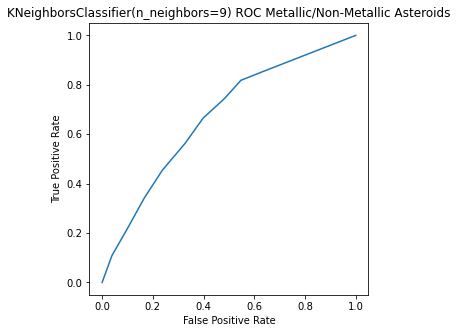

10-Fold Cross Validation ROC AUC Score:  0.6699747672187077


,-1,0,1,2,3,4,5,6,7,8,9,10
0,fpr,0.0,0.038311,0.101642,0.165754,0.237686,0.326818,0.397967,0.482408,0.547303,0.630962,1.0
1,tpr,0.0,0.107955,0.221591,0.340909,0.454545,0.562500,0.664773,0.744318,0.818182,0.852273,1.0
2,threshold,2.0,1.000000,0.888889,0.777778,0.666667,0.555556,0.444444,0.333333,0.222222,0.111111,0.0


In [20]:
knn = KNeighborsClassifier(9)
stats = evaluate_model(knn, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Logistic Regression

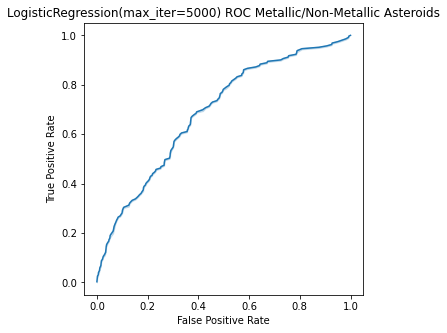

10-Fold Cross Validation ROC AUC Score:  0.6882640912644822


,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298
0,fpr,0.000000,0.000000,0.000782,0.000782,0.001564,0.001564,0.002346,0.002346,0.005473,0.005473,0.006255,0.006255,0.010164,0.010164,0.010946,0.010946,0.011728,0.011728,0.015637,0.015637,0.016419,0.016419,0.017201,0.017201,0.017983,0.017983,0.021892,0.021892,0.023456,0.023456,0.025020,0.025020,0.030493,0.030493,0.034402,0.034402,0.035184,0.035184,0.035966,0.035966,0.036747,0.036747,0.038311,0.038311,0.043002,0.043002,0.046912,0.046912,0.047694,0.047694,0.050821,0.050821,0.052385,0.052385,0.064113,0.064113,0.068022,0.068022,0.073495,0.073495,0.075841,0.075841,0.078186,0.078186,0.081314,0.081314,0.083659,0.083659,0.092260,0.092260,0.095387,0.095387,0.099296,0.099296,0.100860,0.100860,0.105551,0.105551,0.125880,0.125880,0.129007,0.129007,0.133698,0.133698,0.139171,0.139171,0.151681,0.151681,0.157936,0.157936,0.163409,0.163409,0.168100,0.168100,0.174355,0.174355,0.177482,0.177482,0.182955,0.182955,0.183737,0.183737,0.186083,0.186083,0.191556,0.191556,0.193120,0.193120,0.197811,0.197811,0.203284,0.203284,0.207193,0.207193,0.208757,0.208757,0.211102,0.211102,0.218139,0.218139,0.219703,0.219703,0.226740,0.226740,0.231431,0.231431,0.232995,0.232995,0.250977,0.250977,0.252541,0.252541,0.265051,0.265051,0.265833,0.265833,0.268178,0.268178,0.286161,0.286161,0.288507,0.288507,0.289289,0.289289,0.291634,0.291634,0.297107,0.297107,0.301016,0.301016,0.301798,0.301798,0.302580,0.30258,0.303362,0.303362,0.304144,0.304144,0.308053,0.308053,0.313526,0.313526,0.320563,0.320563,0.326036,0.326036,0.327600,0.327600,0.333855,0.333855,0.355747,0.355747,0.356529,0.356529,0.359656,0.359656,0.360438,0.360438,0.362783,0.362783,0.368256,0.368256,0.369038,0.369038,0.370602,0.370602,0.371384,0.371384,0.376075,0.376075,0.383112,0.383112,0.390930,0.390930,0.393276,0.393276,0.417514,0.417514,0.428460,0.428460,0.441751,0.441751,0.446443,0.446443,0.449570,0.449570,0.455825,0.455825,0.473026,0.473026,0.476935,0.476935,0.482408,0.482408,0.483972,0.483972,0.485536,0.485536,0.486317,0.486317,0.493354,0.493354,0.496482,0.496482,0.498045,0.498045,0.508991,0.508991,0.521501,0.521501,0.523065,0.523065,0.528538,0.528538,0.531665,0.531665,0.539484,0.539484,0.547303,0.547303,0.552776,0.552776,0.570758,0.570758,0.571540,0.571540,0.577013,0.577013,0.577795,0.577795,0.578577,0.578577,0.593432,0.593432,0.626271,0.626271,0.641126,0.641126,0.643471,0.643471,0.670055,0.670055,0.673182,0.673182,0.724785,0.724785,0.734949,0.734949,0.753714,0.753714,0.756059,0.756059,0.784988,0.784988,0.787334,0.787334,0.788898,0.788898,0.808444,0.808444,0.874902,0.874902,0.906177,0.906177,0.925723,0.925723,0.927287,0.927287,0.949179,0.949179,0.965598,0.965598,0.981235,0.981235,0.991400,0.991400,0.993745,0.993745,1.000000e+00
1,tpr,0.000000,0.005682,0.005682,0.017045,0.017045,0.022727,0.022727,0.028409,0.028409,0.034091,0.034091,0.045455,0.045455,0.051136,0.051136,0.056818,0.056818,0.062500,0.062500,0.073864,0.073864,0.079545,0.0795

In [21]:
log_reg = LogisticRegression(max_iter = 5000)
stats = evaluate_model(log_reg, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Random Forest

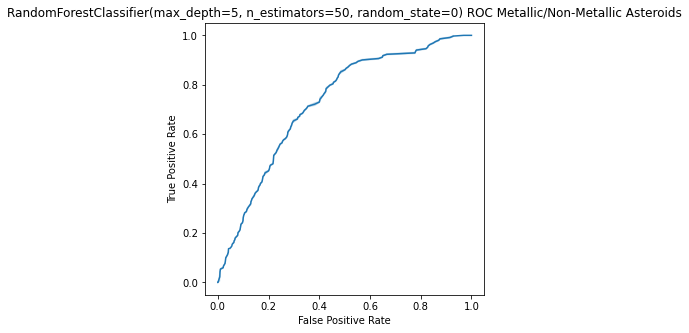

10-Fold Cross Validation ROC AUC Score:  0.7258511621295046


,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298
0,fpr,0.000000,0.000782,0.001564,0.001564,0.007819,0.007819,0.008600,0.008600,0.009382,0.009382,0.010164,0.010164,0.021110,0.02111,0.021892,0.021892,0.025020,0.025020,0.026583,0.028147,0.028147,0.029711,0.029711,0.030493,0.030493,0.031274,0.031274,0.034402,0.034402,0.037529,0.037529,0.041439,0.041439,0.042220,0.049257,0.049257,0.051603,0.053167,0.053167,0.055512,0.056294,0.057858,0.057858,0.063331,0.063331,0.064113,0.064113,0.067240,0.067240,0.068022,0.068022,0.072713,0.072713,0.078186,0.078186,0.078968,0.078968,0.079750,0.079750,0.084441,0.084441,0.087568,0.087568,0.088350,0.088350,0.089914,0.089914,0.091478,0.091478,0.096951,0.096951,0.099296,0.099296,0.100078,0.100078,0.101642,0.101642,0.102424,0.103987,0.103987,0.105551,0.105551,0.112588,0.112588,0.114934,0.114934,0.119625,0.119625,0.123534,0.123534,0.129789,0.129789,0.130571,0.130571,0.132916,0.132916,0.134480,0.134480,0.138389,0.138389,0.143862,0.143862,0.146990,0.146990,0.151681,0.151681,0.157936,0.157936,0.159500,0.159500,0.160281,0.160281,0.162627,0.162627,0.166536,0.166536,0.168100,0.168100,0.173573,0.173573,0.175137,0.175137,0.176701,0.176701,0.178264,0.178264,0.182955,0.182955,0.186083,0.186083,0.200156,0.200156,0.202502,0.202502,0.204066,0.204066,0.204848,0.204848,0.207193,0.207193,0.217357,0.217357,0.218921,0.218921,0.219703,0.219703,0.220485,0.220485,0.225176,0.225176,0.229867,0.229867,0.232995,0.232995,0.239249,0.239249,0.243159,0.243159,0.245504,0.245504,0.253323,0.253323,0.254887,0.254887,0.258796,0.258796,0.266615,0.266615,0.271306,0.271306,0.273651,0.273651,0.275215,0.275215,0.275997,0.275997,0.281470,0.281470,0.286161,0.286161,0.286943,0.286943,0.290852,0.290852,0.293198,0.293198,0.297889,0.297889,0.314308,0.314308,0.315090,0.315090,0.322909,0.322909,0.323690,0.323690,0.333855,0.333855,0.337764,0.337764,0.340891,0.340891,0.347146,0.347146,0.351837,0.351837,0.354965,0.354965,0.382330,0.382330,0.400313,0.400313,0.402658,0.402658,0.411259,0.411259,0.415950,0.415950,0.419077,0.419077,0.425332,0.425332,0.426896,0.426896,0.435496,0.435496,0.441751,0.441751,0.454261,0.454261,0.455825,0.455825,0.464425,0.464425,0.468335,0.468335,0.470680,0.470680,0.474590,0.474590,0.475371,0.475371,0.478499,0.478499,0.484754,0.484754,0.501173,0.501173,0.505864,0.505864,0.513683,0.513683,0.519156,0.519156,0.526974,0.526974,0.544957,0.544957,0.552776,0.552776,0.569977,0.569977,0.634089,0.634089,0.648944,0.648944,0.650508,0.650508,0.666145,0.666145,0.777170,0.777170,0.779515,0.779515,0.782643,0.782643,0.820954,0.820954,0.827209,0.827209,0.829554,0.829554,0.836591,0.836591,0.849101,0.849101,0.857701,0.857701,0.870993,0.870993,0.875684,0.875684,0.915559,0.915559,0.928851,0.928851,0.967944,0.969507,1.000000
1,tpr,0.000000,0.000000,0.000000,0.005682,0.005682,0.039773,0.039773,0.045455,0.045455,0.051136,0.051136,0.056818,0.056818,0.06250,0.062500,0.068182,0.068182,0.073864,0.073864,0.073864,0.079545,0.079545,0.090909,0.

In [22]:
rfc = RandomForestClassifier(n_estimators = 50, max_depth = 5, random_state = 0)
stats = evaluate_model(rfc, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Gradient Boosting

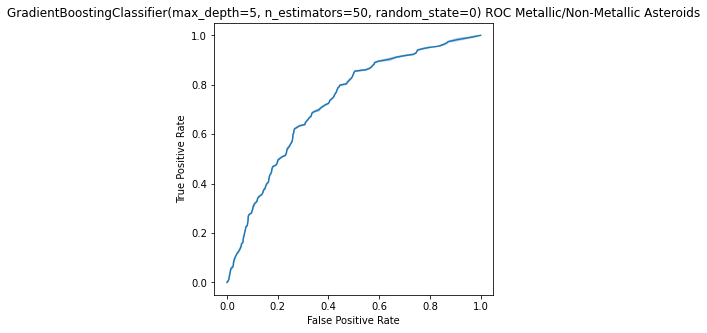

10-Fold Cross Validation ROC AUC Score:  0.7247050252327812


,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288
0,fpr,0.000000,0.000782,0.002346,0.002346,0.005473,0.005473,0.007819,0.007819,0.008600,0.008600,0.010946,0.010946,0.011728,0.011728,0.012510,0.012510,0.014855,0.014855,0.024238,0.024238,0.025801,0.025801,0.031274,0.031274,0.033620,0.033620,0.036747,0.036747,0.039093,0.039093,0.045348,0.045348,0.051603,0.051603,0.056294,0.056294,0.057076,0.057076,0.062549,0.062549,0.063331,0.063331,0.064113,0.064113,0.064894,0.064894,0.068022,0.068022,0.069586,0.069586,0.071931,0.071931,0.073495,0.073495,0.074277,0.074277,0.079750,0.079750,0.080532,0.080532,0.082877,0.082877,0.083659,0.083659,0.084441,0.084441,0.087568,0.087568,0.096951,0.096951,0.097733,0.097733,0.100078,0.100078,0.103206,0.103206,0.110242,0.110242,0.117279,0.117279,0.118843,0.118843,0.121188,0.121188,0.128225,0.128225,0.136826,0.136826,0.139953,0.139953,0.142299,0.142299,0.143081,0.143081,0.150117,0.150117,0.152463,0.152463,0.154808,0.154808,0.157936,0.157936,0.163409,0.163409,0.164191,0.164191,0.164973,0.164973,0.166536,0.166536,0.168882,0.168882,0.172791,0.172791,0.175137,0.175137,0.176701,0.176701,0.180610,0.180610,0.192338,0.192338,0.196247,0.196247,0.198593,0.198593,0.200156,0.200156,0.209539,0.209539,0.217357,0.217357,0.229867,0.229867,0.233776,0.233776,0.235340,0.235340,0.236904,0.236904,0.246286,0.246286,0.250195,0.250195,0.254105,0.254105,0.256450,0.256450,0.258014,0.258014,0.258796,0.258796,0.259578,0.259578,0.260360,0.260360,0.263487,0.263487,0.264269,0.264269,0.266615,0.266615,0.276779,0.276779,0.284597,0.284597,0.307271,0.307271,0.308053,0.308053,0.311962,0.311962,0.316654,0.316654,0.321345,0.321345,0.325254,0.325254,0.332291,0.332291,0.333073,0.333073,0.334636,0.334636,0.341673,0.341673,0.362783,0.362783,0.370602,0.370602,0.379203,0.379203,0.387803,0.387803,0.399531,0.399531,0.403440,0.403440,0.405004,0.405004,0.411259,0.411259,0.417514,0.417514,0.421423,0.421423,0.423769,0.423769,0.426896,0.426896,0.430805,0.430805,0.432369,0.432369,0.434715,0.434715,0.437060,0.437060,0.442533,0.442533,0.444879,0.444879,0.471462,0.471462,0.473808,0.473808,0.481626,0.481626,0.490227,0.490227,0.494136,0.494136,0.495700,0.495700,0.498827,0.498827,0.500391,0.500391,0.504300,0.504300,0.547303,0.547303,0.562158,0.562158,0.569977,0.569977,0.573886,0.573886,0.580141,0.580141,0.581704,0.581704,0.594996,0.594996,0.641908,0.641908,0.668491,0.668491,0.698202,0.698202,0.735731,0.735731,0.745113,0.745113,0.748241,0.748241,0.751368,0.751368,0.771697,0.771697,0.799844,0.799844,0.822518,0.824081,0.838155,0.838155,0.853792,0.853792,0.865520,0.865520,0.871775,0.871775,0.909304,0.909304,0.957780,0.957780,0.985145,0.985145,1.00000
1,tpr,0.000000,0.000000,0.000000,0.005682,0.005682,0.011364,0.011364,0.017045,0.017045,0.028409,0.028409,0.034091,0.034091,0.039773,0.039773,0.045455,0.045455,0.062500,0.062500,0.068182,0.068182,0.096591,0.096591,0.102273,0.102273,0.107955,0.107955,0.113636,0.113636,0.119318,0.119318,0.130682,0.130682,0.142045,0.142045,0.153409,0.153409,0.159

In [23]:
gbc = GradientBoostingClassifier(n_estimators = 50, max_depth = 5, random_state = 0)
stats = evaluate_model(gbc, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Training the Models on Entire Training Set

In [24]:
# Use SMOTE to resample the training set. Recall that we did this previously for cross-validation, but not the actual X_train
os = SMOTE(random_state = 0)
os_processed_X_train, os_y_train = os.fit_resample(processed_X_train, y_train)

knn.fit(os_processed_X_train, os_y_train)
log_reg.fit(os_processed_X_train, os_y_train)
rfc.fit(os_processed_X_train, os_y_train)
gbc.fit(os_processed_X_train, os_y_train)

GradientBoostingClassifier(max_depth=5, n_estimators=50, random_state=0)

### Feature Importance (Random Forest and Gradient Boosting Classifier)

In [25]:
feature_importances = dict(zip(processed_X_train.columns, zip(rfc.feature_importances_ , gbc.feature_importances_)))
feature_importances['Order'] = ('Random Forest', 'Gradient Boosting')
pd.DataFrame(feature_importances).set_index('Order')

,i,data_arc,H,rot_per,n*q,H*sqrt(diameter),Abs(exp(n) + log(albedo)),Abs(sqrt(H) + log(albedo)),1/(exp(ad) + 1/albedo),Abs(exp(albedo) + log(albedo)),albedo*log(albedo)
Order,,,,,,,,,,,
Random Forest,0.071631,0.133682,0.073243,0.041811,0.070456,0.061326,0.117848,0.079860,0.061644,0.146842,0.141656
Gradient Boosting,0.074751,0.146302,0.074325,0.056885,0.082470,0.075828,0.085652,0.057578,0.124439,0.111096,0.110673


## Test Set ROC Assessment

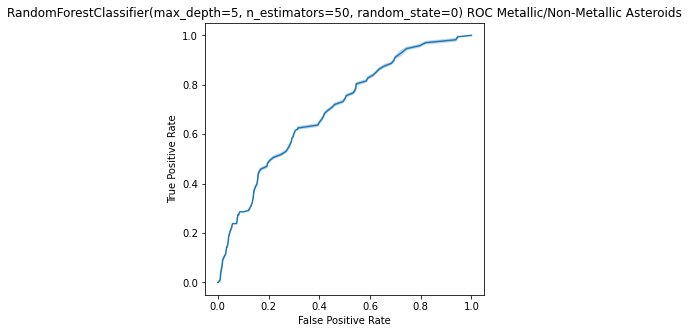

Test Set AUC:  0.6987287817335136


In [26]:
X_test, y_test = asteroids_test.drop('metallic', axis=1), asteroids_test['metallic']

# Reset Indices
X_test = X_test.reset_index().drop('index', axis=1)
y_test = pd.DataFrame(y_test).reset_index().drop('index', axis=1)['metallic']

# Process the test set
processed_X_test = pipeline(X_test, test = True)

best_model = rfc
prediction_probs = best_model.predict_proba(processed_X_test)[:, 1]
fpr, tpr, threshold = roc_curve(y_test, prediction_probs)
plt.subplots(figsize=(5, 5))
sns.lineplot(x = fpr, y = tpr)

# Plot Labels
plt.title(str(best_model) + ' ROC Metallic/Non-Metallic Asteroids')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

    
print("Test Set AUC: ", roc_auc_score(y_test, prediction_probs))

My hope was that I'd get at least 75% area under the ROC. While I didn't manage to achieve that, 70% is still decent improvement over nothing. I chose to use ROC score because I believe that the 'right' balance of tpr and fpr for this problem relies on the availability of resources. If we're short on resources, then it might be best to reduce the fpr at the expense of the tpr. On the other hand, it might be best to increase tpr and the fpr if we have sufficient time or have limited the asteroids of interest to a specific volume in space.

<br/><br/><br/>

## Below is Work In Progress. Please Ignore

In [27]:
#asteroids_BV = asteroids.drop(cleaned_asteroids.index, axis = 'rows')

asteroids_BV = asteroids.drop(asteroids_test.index, axis = 'rows')
asteroids_BV = asteroids_BV[~asteroids_BV['BV'].isna()]
asteroids_BV = asteroids_BV[['BV', 'e', 'i', 'om', 'w', 'q', 'ad', 'data_arc', 'H', 'diameter', 'albedo', 'rot_per', 'n']] 
asteroids_BV['diameter'] = pd.to_numeric(asteroids_BV['diameter'], errors='coerce')

In [28]:
X_train_BV, X_test_BV, y_train_BV, y_test_BV = train_test_split(
    asteroids_BV.drop('BV', axis = 1), 
    asteroids_BV['BV'], 
    test_size = 0.25, 
    random_state = 0
)

In [29]:
imputer_BV = KNNImputer(n_neighbors = 5, weights="uniform", copy = False, add_indicator = True)
imputer_BV.fit(X_train_BV)

KNNImputer(add_indicator=True, copy=False)

In [30]:
def feature_engineering_BV(X):
    X_copy = X.copy()
    
    X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo']) 
    X_copy['Abs(log(diameter) - log(i))'] = abs(np.log(X_copy['diameter']) - np.log(X_copy['i']))
    X_copy['1/(H**3 + diameter**3)'] = 1/(X_copy['H']**3 + X_copy['diameter']**3)
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
    X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
    X_copy['n * exp(-n**2)'] = X_copy['n'] * np.exp(-X_copy['n']**2)
    X_copy['1 / (exp(q) + 1/albedo)'] =1 / (np.exp(X_copy['q']) + 1/X_copy['albedo'])
    X_copy['Abs(albedo**3 - 1/ad)'] = abs(X_copy['albedo']**3 - 1/X_copy['ad'])
    X_copy['Abs(sqrt(ad) - exp(albedo))'] = abs(np.sqrt(X_copy['ad']) - np.exp(X_copy['albedo']))
    X_copy['n*log(ad)'] = X_copy['n'] * np.log(X_copy['ad'])
    X_copy['log(om)/ad'] = np.log(X_copy['om']) / X_copy['ad']
    X_copy['H**3/albedo'] = X_copy['H']**3 / X_copy['albedo']
    X_copy['exp(e)*log(n)'] = np.exp(X_copy['e']) * np.log(X_copy['n'])
    X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])
    
    
    X_copy.drop(['i', 'e', 'om', 'w', 'data_arc', 'H', 'rot_per', 'n', 'diameter'], axis = 'columns', inplace = True)
    
    return X_copy

In [31]:
imputer_BV.transform(X_train_BV)

processed_X_train_BV = feature_engineering_BV(X_train_BV)

model_BV = GradientBoostingRegressor(n_estimators = 10, max_depth = 2, random_state = 0).fit(processed_X_train_BV, y_train_BV)
train_predictions_BV = model_BV.predict(processed_X_train_BV)

print('Train MAE: ', mean_absolute_error(y_train_BV, train_predictions_BV))
print('Train MSE: ', mean_squared_error(y_train_BV, train_predictions_BV))

Train MAE:  0.05057884214277186
Train MSE:  0.004024267586147587


In [32]:
imputer_BV.transform(X_test_BV)

processed_X_test_BV = feature_engineering_BV(X_test_BV)

test_predictions_BV = model_BV.predict(processed_X_test_BV)

print('Test MAE: ', mean_absolute_error(y_test_BV, test_predictions_BV))
print('Test MSE: ', mean_squared_error(y_test_BV, test_predictions_BV))

Test MAE:  0.04982207486276643
Test MSE:  0.0039488832314077925


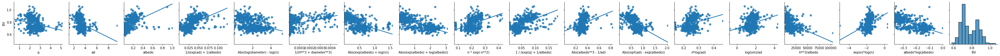

In [33]:
sns.pairplot(pd.concat([processed_X_train_BV, 
                        y_train_BV,
                       ], axis = 1),
             y_vars=['BV'],
             kind = 'reg',
             plot_kws = {'ci':None}
            )

In [34]:
#asteroids_UB = asteroids.drop(cleaned_asteroids.index, axis = 'rows')

asteroids_UB = asteroids.drop(asteroids_test.index, axis = 'rows')
asteroids_UB = asteroids_UB[~asteroids_UB['UB'].isna()]
asteroids_UB = asteroids_UB[['UB', 'e', 'i', 'om', 'w', 'q', 'ad', 'data_arc', 'H', 'diameter', 'albedo', 'rot_per', 'n']]  
asteroids_UB['diameter'] = pd.to_numeric(asteroids_UB['diameter'], errors='coerce')

In [35]:
X_train_UB, X_test_UB, y_train_UB, y_test_UB = train_test_split(
    asteroids_UB.drop('UB', axis = 1), 
    asteroids_UB['UB'], 
    test_size = 0.25, 
    random_state = 0
)

In [36]:
imputer_UB = KNNImputer(n_neighbors = 5, weights="uniform", copy = False, add_indicator = True)
imputer_UB.fit(X_train_UB)

KNNImputer(add_indicator=True, copy=False)

In [37]:
def feature_engineering_UB(X):
    X_copy = X.copy()
    
    X_copy['n*q'] = X_copy['n']*X_copy['q']
#     X_copy['H*sqrt(diameter)'] = X_copy['H']*np.sqrt(X_copy['diameter'])
#     X_copy['Abs(albedo - sqrt(e))'] = abs(X_copy['albedo'] - np.sqrt(X_copy['e']))
#     X_copy['Abs(exp(n) + log(albedo))'] = abs(np.exp(X_copy['n']) + np.log(X_copy['albedo']))
#     X_copy['Abs(sqrt(H) + log(albedo))'] = abs(np.sqrt(X_copy['H']) + np.log(X_copy['albedo']))
#     X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo'])
#     X_copy['1/(diameter**2 + w)'] = 1/(X_copy['diameter']**2 + X_copy['w']) 
#     X_copy['Abs(log(diameter) - log(i))'] = abs(np.log(X_copy['diameter']) - np.log(X_copy['i']))
#     X_copy['1/(H**3 + diameter**3)'] = 1/(X_copy['H']**3 + X_copy['diameter']**3)
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
#     X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
#     X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
#     X_copy['n * exp(-n**2)'] = X_copy['n'] * np.exp(-X_copy['n']**2)
#     X_copy['1 / (exp(q) + 1/albedo)'] =1 / (np.exp(X_copy['q']) + 1/X_copy['albedo'])
#     X_copy['Abs(albedo**3 - 1/ad)'] = abs(X_copy['albedo']**3 - 1/X_copy['ad'])
#     X_copy['Abs(sqrt(ad) - exp(albedo))'] = abs(np.sqrt(X_copy['ad']) - np.exp(X_copy['albedo']))
#     X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])
    X_copy['n*log(ad)'] = X_copy['n'] * np.log(X_copy['ad'])
    X_copy['log(om)/ad'] = np.log(X_copy['om']) / X_copy['ad']
#     X_copy['H**3/albedo'] = X_copy['H']**3 / X_copy['albedo']
    X_copy['exp(e)*log(n)'] = np.exp(X_copy['e']) * np.log(X_copy['n'])
    
    
    X_copy.drop(['e', 'om', 'w', 'data_arc', 'H', 'rot_per', 'n', 'albedo'], axis = 'columns', inplace = True)
    
    return X_copy

In [38]:
imputer_UB.transform(X_train_UB)

processed_X_train_UB = feature_engineering_UB(X_train_UB)

model_UB = GradientBoostingRegressor(n_estimators = 10, max_depth = 2, random_state = 0).fit(processed_X_train_UB, y_train_UB)
train_predictions_UB = model_UB.predict(processed_X_train_UB)

print('Train MAE: ', mean_absolute_error(y_train_UB, train_predictions_UB))
print('Train MSE: ', mean_squared_error(y_train_UB, train_predictions_UB))

Train MAE:  0.06388749061699289
Train MSE:  0.005907574303932846


In [39]:
imputer_UB.transform(X_test_UB)

processed_X_test_UB = feature_engineering_UB(X_test_UB)

test_predictions_UB = model_UB.predict(processed_X_test_UB)

print('Test MAE: ', mean_absolute_error(y_test_UB, test_predictions_UB))
print('Test MSE: ', mean_squared_error(y_test_UB, test_predictions_UB))


Test MAE:  0.07331238878837452
Test MSE:  0.008295280074985971


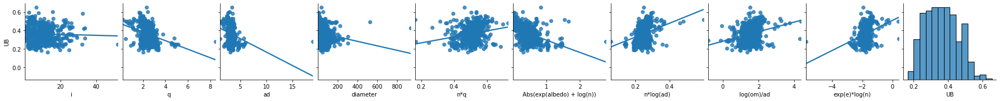

In [40]:
sns.pairplot(pd.concat([processed_X_train_UB, 
                        y_train_UB,
                       ], axis = 1),
             y_vars=['UB'],
             kind = 'reg',
             plot_kws = {'ci':None}
            )